# Photometry with Python
Measuring the brightness of a star and its error with Python.

The package we are going to use is ```photutils```. It supports aperture photometry (adding the values of pixels inside a given aperture together) and PSF photometry (fitting a PSF, usually 2-d gaussian, to get its brightness). The number we get is only a representation of the flux, with unknown zeropoint and scaling factor. The apparent magnitude of an star can be recovered by doing photometry on 1 or more stars with known magnitude.
$$
m-m_0=-2.5\log\frac{F}{F_0}
$$
where $F_0$ is the flux measured from the image of the star with known magnitude $m_0$.

In [1]:
# Import necessary modules
from astropy.coordinates import SkyCoord
from astropy.io import fits
from astropy.stats import sigma_clipped_stats
from astropy.table import Table
from astropy.time import Time
import astropy.units as u
from astropy.visualization import ImageNormalize, ZScaleInterval, LinearStretch
from astropy.wcs import WCS
from astropy.wcs.utils import skycoord_to_pixel
import glob
from photutils.aperture import aperture_photometry, SkyCircularAperture, CircularAperture, CircularAnnulus
from photutils.centroids import centroid_com
import matplotlib.pyplot as plt
from matplotlib.patches import Circle
from matplotlib.collections import PatchCollection
import numpy as np
%matplotlib inline


def initPlot(mn, labels, lim, figSize=(16, 9), share=('none', 'none'),
        spkw=None, gskw=None):
    '''
    Initialize a plot with both axis label and tick shown

    Parameters
    ----------
    mn: 2-tuple, (number of rows, number of columns)
    labels: list of 2-tuple str, string for x and y axis. Allow latex.
    lim: list of 2-tuple, limit for x and y axis.
    figSize: 2-tuple, default (16, 9). Size of the figure in inch. DPI is fixed
             at 300.
    share: 2-tuple, default ('none', 'none'). Whether to share x or y axis.
    spkw: dict, keywords to pass to add_subplot
    gskw: dict, keywords to pass to GridSpec

    Returns
    -------
    fig: matplotlib.pyplot.Figure, the figure itself
    ax: matplotlib.pyplot.axes, the axes in 2D array
    '''
    # Set up the Figure and axes
    fig, ax = plt.subplots(nrows=mn[0], ncols=mn[1], sharex=share[0],
            sharey=share[1], squeeze=False, subplot_kw=spkw, gridspec_kw=gskw,
            figsize=figSize, dpi=300)
    # Set up the limit and labels for each axes
    for i in range(mn[0]):
        for j in range(mn[1]):
            num = i * mn[1] + j
            ax[i][j].set_xlabel(labels[num][0], fontsize=24)
            ax[i][j].set_xlim(lim[num][0])
            ax[i][j].set_ylabel(labels[num][1], fontsize=24)
            ax[i][j].set_ylim(lim[num][1])
            ax[i][j].tick_params(axis='both', which='major', labelsize=20)
    return fig, ax


def normFits(img, norm, stretch):
    '''
    Normalize a fits image with astropy
    
    Parameters
    ----------
    img: 2d numpy.array, the image data
    norm: astropy.visualization.interval, the interval of the image, usually ZScale or MinMax
    stretch: astropy.visualization.stretch, the stretch of the image, usually Linear, Sqrt, etc.
    
    Returns
    -------
    ImageNormalize: astropy.visulization.ImageNormalize, the normalization withe interval and stretch combined
    '''
    return ImageNormalize(img, interval=norm, stretch=stretch)

In [2]:
%pwd

'/home/wyz5rge/Documents/ASTR-3130/Lab 4'

In [3]:
# Move to the folder with your calibrated data here: 

#for example: 
%cd '/home/wyz5rge/Documents/ASTR-3130/Lab 4'
%pwd

/home/wyz5rge/Documents/ASTR-3130/Lab 4


'/home/wyz5rge/Documents/ASTR-3130/Lab 4'

Sometimes we need to use the WCS information stored in the header of a fits file, so there is one extra step involved in opening up the file.

In [4]:
# Open a fits image with wcs coordinates
f = fits.open("./calibrated/night1_reduced/messier_3_6099763_V_1.fits")
img = f[0].data  # Image data
header = f[0].header  # Header data
wcs = WCS(header)  # Construct wcs from information in the header
f.close()

The image does not come with an estimated error for the counts (ADU) of each pixel, so we have to estimate this uncertainty ourselves.

There are 2 main catagories of noises: shot noise and readout noise. 

Shot noise comes from both astronomical objects (a.k.a. object shot noise) and sky (a.k.a. sky noise). We know from quantum mechanics, the number of photon emitted from a source follows Poisson distribution. Thus the standard deviation is the square root of the mean value. In another word, the shot noise is just the square root of the counts of each pixel.

Readout noise originates from the process of converting electrons into analogue voltages. It is normally a constant for a given gain and given detector, in electrons.

Since these noises are independent of each other, the total noise in counts would be the squared sum of all contributions
$$
\sigma_{ADU, tot}^2=\sigma_{ADU, object}^2+\sigma_{ADU, sky}^2+\sigma_{ADU, readout}^2=ADU_{object}+ADU_{sky}+(\frac{\sigma_{e-, readout}}{GAIN})^2=ADU_{tot}+(\frac{\sigma_{e-, readout}}{GAIN})^2
$$

In [5]:
img_err = np.sqrt(img + header["RDNOISE"] ** 2.0 / header["GAIN"] ** 2.0)

/tmp/ipykernel_417736/1309658132.py:1: RuntimeWarning: invalid value encountered in sqrt
  img_err = np.sqrt(img + header["RDNOISE"] ** 2.0 / header["GAIN"] ** 2.0)


## Curve of Growth
If one assumes an aperture radius that is too large, one might count background or pixels from other nearby objects into the object. If one assumes an aperture radius that is too small, one might leave part of the star light out. Therefore, we need to determine the most optimal value to use.

We generally plot out the magnitude/flux inside the aperture with respect to its radius. It should be increasing very sharply at small radius and slow down at larger radius. Take a radius that is large enough to cover most of the light but is still small enough that the background does not contribute a lot.

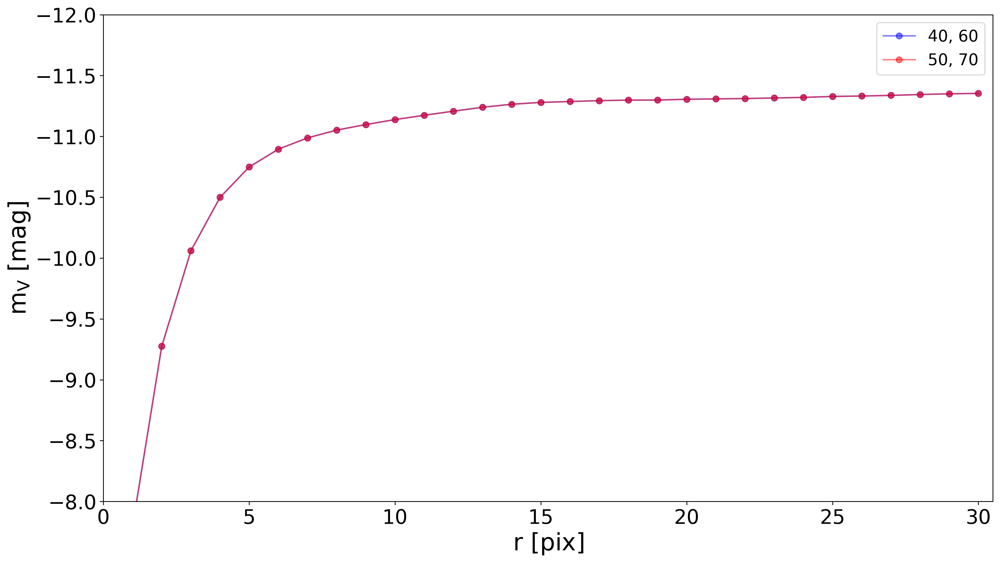

In [6]:
def phot_fixed_aperture(img, wcs, star_sc, img_err=None, radius=10.0, r_in=20.0, r_out=30.0):
    '''
    Aperture photometry with fixed aperture and local background estimation. Allow multiple stars. The image is assumed to be stored 
    in (y, x) format.
    
    The aperture and annulus will be automatically centered at the "center of mass" of the given star.
    
    Parameters
    ----------
    img: 2d numpy.array. The input image data.
    wcs: astropy.wcs.WCS. The wcs for input image data.
    star_sc: 2d numpy.array. The input star position in (RA, Dec).
    img_err: 2d numpy.array, default None. The error of the input image data.
    radius: float, default 10.0. The size of the aperture in pixels.
    r_in: float, default 20.0. The inner radius of the annulus.
    r_out: float, default 30.0. The outer radius of the annulus.
    
    Returns
    -------
    phot: astropy.table.QTable. The output result of photometry. It's not well documented but column names are quite self-explanatory.
    
    Raises
    ------
    None
    '''
    sc = SkyCoord(ra=star_sc[:, 0], dec=star_sc[:, 1], frame='icrs')
    x_pix, y_pix = skycoord_to_pixel(sc, wcs)
    # Star centering
    # Mask support inside photutils.centroid.centroid_com is currently bugged under numpy
    # So we have to do it on our own
    x_min = np.floor(x_pix - radius).astype(np.int64)
    y_min = np.floor(y_pix - radius).astype(np.int64)
    x_max = np.ceil(x_pix + radius).astype(np.int64)
    y_max = np.ceil(y_pix + radius).astype(np.int64)
    centroid = []
    for i in range(x_pix.shape[0]):
        star_cutout = img[y_min[i]: y_max[i], x_min[i]: x_max[i]]
        centroid_cutout = centroid_com(star_cutout)
        centroid.append([centroid_cutout[0] + x_min[i], centroid_cutout[1] + y_min[i]])
    # Aperture/annulus list after star centering
    aperture_list = CircularAperture(centroid, radius)
    annulus_list = CircularAnnulus(centroid, r_in, r_out)
    # Photometry
    phot = aperture_photometry(img, aperture_list, error=img_err, wcs=wcs)
    # Background estimation
    annulus_mask = annulus_list.to_mask(method='center')
    bkg_median = []
    for mask in annulus_mask:
        annulus_data = mask.multiply(img)
        annulus_data_1d = annulus_data[mask.data > 0]
        _, median_sigclip, _ = sigma_clipped_stats(annulus_data_1d)
        bkg_median.append(median_sigclip)
    # Pack everything into the QTable
    phot['bg_median'] = bkg_median
    phot['aperture_bg'] = phot['bg_median'] * aperture_list.area
    phot['aperture_sum_bgsub'] = phot['aperture_sum'] - phot['aperture_bg']
    return phot


star_sc = np.array([['13h42m45.25s', '+28d22m41.3s']])
# Curve of growth
radius_list = np.arange(1, 31)
mag_cog_40 = np.empty_like(radius_list, dtype=np.float64)
mag_cog_50 = np.empty_like(radius_list, dtype=np.float64)
for i in range(radius_list.shape[0]):
    phot_table = phot_fixed_aperture(img, wcs, star_sc, img_err, radius_list[i], r_in=40.0, r_out=60.0)
    mag_cog_40[i] = -2.5 * np.log10(phot_table['aperture_sum_bgsub'][0])
    phot_table = phot_fixed_aperture(img, wcs, star_sc, img_err, radius_list[i], r_in=50.0, r_out=70.0)
    mag_cog_50[i] = -2.5 * np.log10(phot_table['aperture_sum_bgsub'][0])
fig, ax = initPlot((1, 1), [[r"$\rm r\ [pix]$", r"$\rm m_{V}\ [mag]$"]], [[[0.0, 30.5], [-8, -12.0]]])
ax[0][0].plot(radius_list, mag_cog_40, 'bo-', alpha=0.5, label='40, 60')
ax[0][0].plot(radius_list, mag_cog_40, 'ro-', alpha=0.5, label='50, 70')
ax[0][0].legend(fontsize=16)
plt.show()

## Photometry
Once the aperture radius is determined, we can start on the photometry. However, as you might have noticed, the summed flux inside an aperture will include the contribution from the background which we do not want. Thus, the level of the background must be estimated.

Since we generally believe background is slow changing, we can split the entire image into grids (i.e. 64x64 pixel) and use the sigma-clipped mean inside the grid as the value of the background at the center of the grid. Interpolate the values through the entire image would give us the value of the background at any point of the image. However, this is likely to introduce large deviation at parts of the image that has a large background gradient.

We could could also only use local information. Draw an annulus around our where we are insterested in, and use the sigma-clipped mean inside the annulus as a good approximation of the background value. However, there is a trade off. It would be hard to evaluate the level of background for the entire image this way. Also, we can any large-scale structure (galaxies, nebula) for background if we are going to subtract the background from the entire image.

Normally, in aperture photometry, the second method is preferred. However, if background is ruining your astrophotography, use the first method.

In [7]:
# Load the star position from catalog
rr_lyr = np.genfromtxt('/home/3130_Shared_Data/Sp24/Lab4/rr_lyr.txt', dtype='str')
star_sc = rr_lyr[:, 1:]
phot = phot_fixed_aperture(img, wcs, star_sc, img_err)
phot['name'] = rr_lyr[:, 0]
phot.show_in_notebook()

idx,id,xcenter,ycenter,aperture_sum,aperture_sum_err,bg_median,aperture_bg,aperture_sum_bgsub,name
,,pix,pix,,,,,,
0,1,839.966096794159,2000.9995885330052,41459.010705282984,244.6821426183416,42.023794174194336,13202.164305361848,28256.846399921138,72
1,2,658.6607810519665,2296.861545413118,64332.49646551552,287.650544676837,41.53279495239258,13047.912350548777,51284.58411496674,86
2,3,2854.0276016953003,3061.6651940129477,49143.6340887154,259.9114726812051,43.54731369018555,13680.792077265714,35462.842011449684,93
3,4,2085.522017221319,2830.578982833091,64107.39995139664,287.2590119784256,46.96307373046875,14753.884742163644,49353.515209232995,203
4,5,813.8399514529194,2330.6515059024587,54287.62245690771,269.6255954944809,41.618309020996094,13074.777387519114,41212.8450693886,"C01,V=15.74"
5,6,2725.68092912271,2978.797751946994,54431.72401937733,269.89268957358496,43.598121643066406,13696.753866417159,40734.97015296017,"C02,V=15.70"
6,7,1918.537004490755,3250.880374701058,84130.82982409955,320.22050250663966,43.928466796875,13800.534857252565,70330.29496684698,"C03,V=15.05"
7,8,1531.7117447756718,855.5762824833625,46563.690658983774,254.90004076049297,43.33793258666992,13615.013063605193,32948.677595378584,"C04,V=15.99"


```QTable``` is very similar to a dictionary. It has named columns and indexed rows. To access one column, use the key of the column (the name of the column). To access one row, use it index just as a normal array.

Now let's take a look at the aperture and annulus on the image.

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


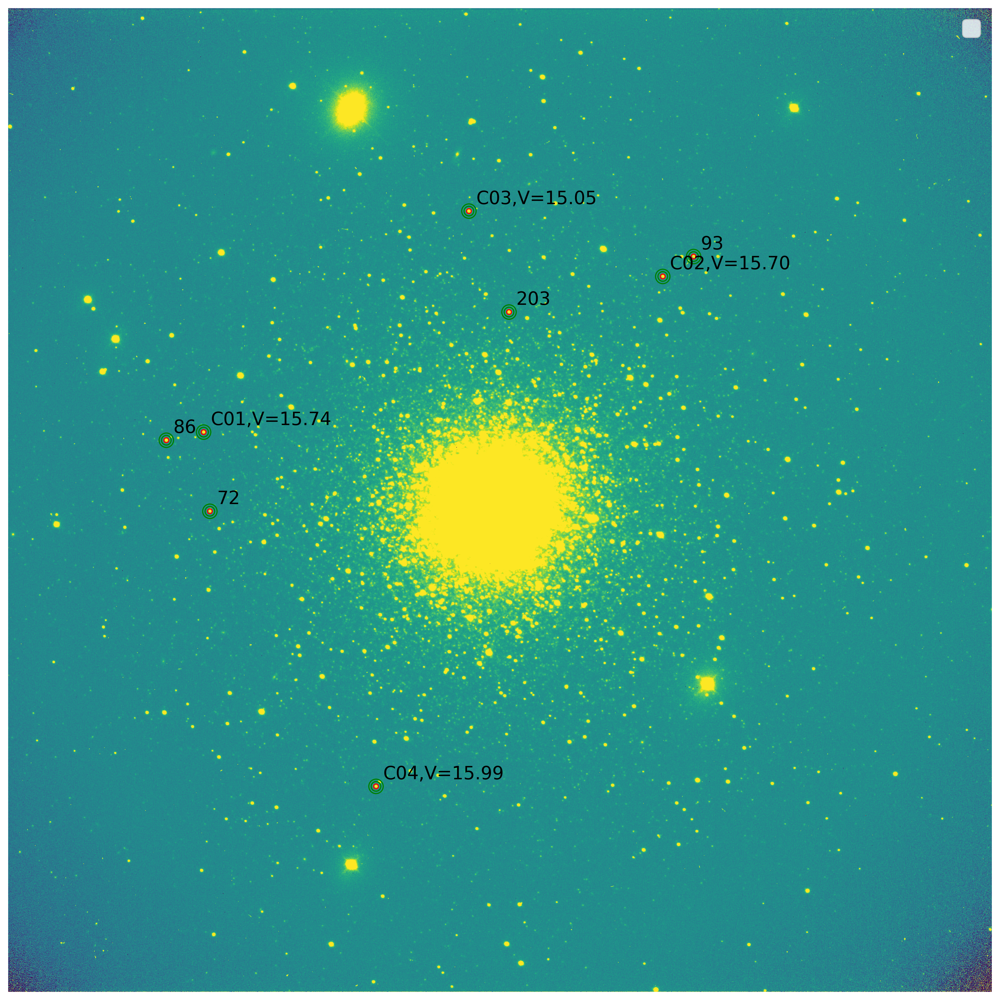

In [8]:
# Check aperture and annulus for all the stars
fig, ax = initPlot((1, 1), [["", ""]], [[[-0.5, img.shape[1] - 0.5], [-0.5, img.shape[0] - 0.5]]], figSize=(16, 16))
z_linear = normFits(img, ZScaleInterval(), LinearStretch())
ax[0][0].imshow(img, origin='lower', norm=z_linear)
# ax[0][0].scatter(phot['xcenter'].value, phot['ycenter'].value, color='r', marker='+')
for i in range(len(phot)):
    sc = SkyCoord(ra=star_sc[i, 0], dec=star_sc[i, 1], frame='icrs')
    x_pix, y_pix = skycoord_to_pixel(sc, wcs)
    ax[0][0].text(x_pix + 30, y_pix + 30, phot['name'][i], fontsize=16)
    # ax[0][0].scatter(x_pix, y_pix, color='b', marker='+')
    for each in [[10, 'r', 'Aperture'], [20, 'g', 'Annulus'], [30, 'g', '']]:
        c = Circle((phot['xcenter'][i].value, phot['ycenter'][i].value), each[0], fill=False, ec=each[1], lw=1)
        ax[0][0].add_patch(c)
ax[0][0].axis('off')
ax[0][0].legend(fontsize=20)
ax[0][0].set_xlim([0, 4096])
ax[0][0].set_ylim([0, 4096])
fig.savefig('./M3_V_000.pdf', bbox_inches='tight', pad_inches=0)
plt.show()

## Photometry on multiple images
Basically, pack up all the requires into a function with 
* A list of file names
* (RA, Dec) of the stars
* Radius of the circular aperture
* Inner and outer radius of the circular annulus

as input parameters and 
* Observation time
* Magnitude of the stars
* Any uncertainty measurements
* Any useful information

as return.

In [9]:
def phot_fixed_aperture_multiple(img_list, star_sc, radius=10.0, r_in=20.0, r_out=30.0):
    '''
    Fixed aperture photometry on multiple images
    
    Parameters
    ----------
    img_list: str, pattern of the path to the images
    star_sc: 2d numpy.array. The input star position in (RA, Dec).
    radius: float, default 10.0. The size of the aperture in pixels.
    r_in: float, default 20.0. The inner radius of the annulus.
    r_out: float, default 30.0. The outer radius of the annulus.
    
    Returns
    -------
    t: astropy.table.Table, the table with photometry information
    '''
    # Intialize the table
    t = Table()
    date_obs = []
    for each_col in ["aperture_sum", "aperture_sum_err", "x_image", "y_image", "bg_median", "aperture_sum_bgsub"]:
        t[each_col] = np.empty((len(img_list), len(star_sc)))
        t[each_col][:] = np.nan
    # Loop through the image
    for i, each_img in enumerate(img_list):
        # Open up the fits image
        f = fits.open(each_img)
        img = f[0].data
        header = f[0].header
        wcs = WCS(header)
        f.close()
        date_obs.append(header["JD-HELIO"])
        # Prepare the error image
        img_err = np.sqrt(img + header["RDNOISE"] ** 2.0 / header["GAIN"] ** 2.0)
        # Do photometry
        phot = phot_fixed_aperture(img, wcs, star_sc, img_err=img_err, radius=radius, r_in=r_in, r_out=r_out)
        # Parse the returns
        t["aperture_sum"][i] = phot["aperture_sum"]
        t["aperture_sum_err"][i] = phot["aperture_sum_err"]
        t["x_image"][i] = phot["xcenter"].value
        t["y_image"][i] = phot["ycenter"].value
        t["bg_median"][i] = phot["bg_median"]
        t["aperture_sum_bgsub"][i] = phot["aperture_sum_bgsub"]
    # Calculate magnitude and its error
    t["aperture_sum_bgsub_err"] = np.sqrt(t["aperture_sum"] - t["aperture_sum_bgsub"] + t["aperture_sum_err"] ** 2.0)
    t["mag_ins"] = -2.5 * np.log10(t["aperture_sum_bgsub"])
    t["mag_ins_err"] = np.abs(-2.5 / np.log(10.0) * t["aperture_sum_bgsub_err"] / t["aperture_sum_bgsub"])
    t["jd"] = date_obs
    return t


# Grab all fits file under the directory
img_list = glob.glob("./calibrated/night*/*.fits")
phot_data = phot_fixed_aperture_multiple(img_list, star_sc)
phot_data.show_in_notebook()

/tmp/ipykernel_417736/1952051240.py:33: RuntimeWarning: invalid value encountered in sqrt
  img_err = np.sqrt(img + header["RDNOISE"] ** 2.0 / header["GAIN"] ** 2.0)
/tmp/ipykernel_417736/1952051240.py:33: RuntimeWarning: invalid value encountered in sqrt
  img_err = np.sqrt(img + header["RDNOISE"] ** 2.0 / header["GAIN"] ** 2.0)
/tmp/ipykernel_417736/1952051240.py:33: RuntimeWarning: invalid value encountered in sqrt
  img_err = np.sqrt(img + header["RDNOISE"] ** 2.0 / header["GAIN"] ** 2.0)
/tmp/ipykernel_417736/1952051240.py:33: RuntimeWarning: invalid value encountered in sqrt
  img_err = np.sqrt(img + header["RDNOISE"] ** 2.0 / header["GAIN"] ** 2.0)
/tmp/ipykernel_417736/1952051240.py:33: RuntimeWarning: invalid value encountered in sqrt
  img_err = np.sqrt(img + header["RDNOISE"] ** 2.0 / header["GAIN"] ** 2.0)
/tmp/ipykernel_417736/1952051240.py:33: RuntimeWarning: invalid value encountered in sqrt
  img_err = np.sqrt(img + header["RDNOISE"] ** 2.0 / header["GAIN"] ** 2.0)
/tmp

/tmp/ipykernel_417736/1952051240.py:33: RuntimeWarning: invalid value encountered in sqrt
  img_err = np.sqrt(img + header["RDNOISE"] ** 2.0 / header["GAIN"] ** 2.0)
/tmp/ipykernel_417736/1952051240.py:33: RuntimeWarning: invalid value encountered in sqrt
  img_err = np.sqrt(img + header["RDNOISE"] ** 2.0 / header["GAIN"] ** 2.0)
/tmp/ipykernel_417736/1952051240.py:33: RuntimeWarning: invalid value encountered in sqrt
  img_err = np.sqrt(img + header["RDNOISE"] ** 2.0 / header["GAIN"] ** 2.0)
/tmp/ipykernel_417736/1952051240.py:33: RuntimeWarning: invalid value encountered in sqrt
  img_err = np.sqrt(img + header["RDNOISE"] ** 2.0 / header["GAIN"] ** 2.0)
/tmp/ipykernel_417736/1952051240.py:33: RuntimeWarning: invalid value encountered in sqrt
  img_err = np.sqrt(img + header["RDNOISE"] ** 2.0 / header["GAIN"] ** 2.0)
/tmp/ipykernel_417736/1952051240.py:33: RuntimeWarning: invalid value encountered in sqrt
  img_err = np.sqrt(img + header["RDNOISE"] ** 2.0 / header["GAIN"] ** 2.0)
/tmp

/tmp/ipykernel_417736/1952051240.py:33: RuntimeWarning: invalid value encountered in sqrt
  img_err = np.sqrt(img + header["RDNOISE"] ** 2.0 / header["GAIN"] ** 2.0)
/tmp/ipykernel_417736/1952051240.py:33: RuntimeWarning: invalid value encountered in sqrt
  img_err = np.sqrt(img + header["RDNOISE"] ** 2.0 / header["GAIN"] ** 2.0)
/tmp/ipykernel_417736/1952051240.py:33: RuntimeWarning: invalid value encountered in sqrt
  img_err = np.sqrt(img + header["RDNOISE"] ** 2.0 / header["GAIN"] ** 2.0)
/tmp/ipykernel_417736/1952051240.py:33: RuntimeWarning: invalid value encountered in sqrt
  img_err = np.sqrt(img + header["RDNOISE"] ** 2.0 / header["GAIN"] ** 2.0)
/tmp/ipykernel_417736/1952051240.py:33: RuntimeWarning: invalid value encountered in sqrt
  img_err = np.sqrt(img + header["RDNOISE"] ** 2.0 / header["GAIN"] ** 2.0)
/tmp/ipykernel_417736/1952051240.py:33: RuntimeWarning: invalid value encountered in sqrt
  img_err = np.sqrt(img + header["RDNOISE"] ** 2.0 / header["GAIN"] ** 2.0)
/tmp

/tmp/ipykernel_417736/1952051240.py:33: RuntimeWarning: invalid value encountered in sqrt
  img_err = np.sqrt(img + header["RDNOISE"] ** 2.0 / header["GAIN"] ** 2.0)
/tmp/ipykernel_417736/1952051240.py:33: RuntimeWarning: invalid value encountered in sqrt
  img_err = np.sqrt(img + header["RDNOISE"] ** 2.0 / header["GAIN"] ** 2.0)
/tmp/ipykernel_417736/1952051240.py:33: RuntimeWarning: invalid value encountered in sqrt
  img_err = np.sqrt(img + header["RDNOISE"] ** 2.0 / header["GAIN"] ** 2.0)
/tmp/ipykernel_417736/1952051240.py:33: RuntimeWarning: invalid value encountered in sqrt
  img_err = np.sqrt(img + header["RDNOISE"] ** 2.0 / header["GAIN"] ** 2.0)
/tmp/ipykernel_417736/1952051240.py:33: RuntimeWarning: invalid value encountered in sqrt
  img_err = np.sqrt(img + header["RDNOISE"] ** 2.0 / header["GAIN"] ** 2.0)
/tmp/ipykernel_417736/1952051240.py:33: RuntimeWarning: invalid value encountered in sqrt
  img_err = np.sqrt(img + header["RDNOISE"] ** 2.0 / header["GAIN"] ** 2.0)
/tmp

/tmp/ipykernel_417736/1952051240.py:33: RuntimeWarning: invalid value encountered in sqrt
  img_err = np.sqrt(img + header["RDNOISE"] ** 2.0 / header["GAIN"] ** 2.0)
/tmp/ipykernel_417736/1952051240.py:33: RuntimeWarning: invalid value encountered in sqrt
  img_err = np.sqrt(img + header["RDNOISE"] ** 2.0 / header["GAIN"] ** 2.0)
/tmp/ipykernel_417736/1952051240.py:33: RuntimeWarning: invalid value encountered in sqrt
  img_err = np.sqrt(img + header["RDNOISE"] ** 2.0 / header["GAIN"] ** 2.0)
/tmp/ipykernel_417736/1952051240.py:33: RuntimeWarning: invalid value encountered in sqrt
  img_err = np.sqrt(img + header["RDNOISE"] ** 2.0 / header["GAIN"] ** 2.0)
/tmp/ipykernel_417736/1952051240.py:33: RuntimeWarning: invalid value encountered in sqrt
  img_err = np.sqrt(img + header["RDNOISE"] ** 2.0 / header["GAIN"] ** 2.0)
/tmp/ipykernel_417736/1952051240.py:33: RuntimeWarning: invalid value encountered in sqrt
  img_err = np.sqrt(img + header["RDNOISE"] ** 2.0 / header["GAIN"] ** 2.0)
/tmp

idx,aperture_sum [8],aperture_sum_err [8],x_image [8],y_image [8],bg_median [8],aperture_sum_bgsub [8],aperture_sum_bgsub_err [8],mag_ins [8],mag_ins_err [8],jd
0,306765.0112077205 .. 313087.61294544395,570.230648386701 .. 575.7478563548813,803.1638376203626 .. 1495.1917029381118,1924.133252664668 .. 779.1330015366702,867.9255032382907 .. 866.3699647042951,34098.17272405664 .. 40909.461304857745,773.1945620884702 .. 776.958007705582,-11.331827765874054 .. -11.529559401882818,0.024619657369184866 .. 0.020620448464388045,2459303.8523216406
1,363831.55334802205 .. 352384.7570013709,618.2471467785508 .. 608.9193199046715,782.1222184933946 .. 1473.1485694974963,1912.1909419292801 .. 767.1228236645388,1005.5414487196433 .. 999.6991588565074,47931.3905302551 .. 38320.00367502094,835.5415593000662 .. 827.5551289669575,-11.701550071063698 .. -11.45856385514213,0.018926588848690244 .. 0.023447455083058982,2459303.706358837
2,418627.7704646239 .. 365799.14465933584,661.0792324800567 .. 619.8363701906599,744.2435403733251 .. 1436.0764303904666,1936.1631465108783 .. 791.0988655387587,1055.1469689840974 .. 1055.014113895565,87143.57384282612 .. 34356.68569455057,876.646991803553 .. 845.9548361324722,-12.35058841701149 .. -11.340028154633115,0.010922289915606618 .. 0.026733771742276626,2459303.5675258017
3,437542.73227988183 .. 382120.71935082995,675.233821303168 .. 632.8654679334518,750.3138923007241 .. 1442.112029854447,1935.180970761834 .. 790.0842650192045,1107.8979607238334 .. 1108.6575041054225,89486.32284617098 .. 33825.692326350836,896.6588664957201 .. 865.3402380145661,-12.379391656269021 .. -11.323116735675026,0.010879148496752047 .. 0.027775668766268514,2459303.5784750334
4,298867.0556258789 .. 303990.69719162444,563.2628487461923 .. 567.7928128670011,802.1657521257139 .. 1494.1424795507057,1924.163477144701 .. 779.1224685493227,836.9908320818932 .. 837.4486810246799,35918.63070683053 .. 40898.434785064775,761.7174421639064 .. 765.1672632503177,-11.388299430246892 .. -11.529266718843736,0.02302493687755856 .. 0.020312997423313217,2459303.8340806286
5,317196.21949759626 .. 323191.37767777446,579.3049289013458 .. 584.4564644433076,801.1198936360754 .. 1493.1321923345824,1925.1389895452805 .. 780.1028864906892,901.8986025294159 .. 900.0266275174945,33856.41709866485 .. 40439.67357335868,786.7235874488096 .. 790.152556747105,-11.324102491002662 .. -11.517019103334672,0.02522931707572966 .. 0.021214247355045658,2459303.8778775777
6,410227.6726841 .. 379415.12410414626,654.6950846278723 .. 630.7242703875784,763.2156972698663 .. 1455.0951427123666,1925.2309710976103 .. 780.1218190106339,1083.8162622396271 .. 1084.807758411706,69736.75195478386 .. 38612.71566580364,876.9929159150678 .. 859.4274336407267,-12.108654289741995 .. -11.46682586751507,0.013653961984675892 .. 0.024165911772232273,2459303.6295868848
7,380270.9149987692 .. 358174.90730034315,631.402325107032 .. 613.6553498928695,767.1630067560033 .. 1458.1533925920805,1921.1638797381022 .. 776.0970554169376,1015.5251361428182 .. 1014.1429051103443,61234.28427456395 .. 39572.517261856294,847.175027296468 .. 833.7717184521354,-11.967486615097194 .. -11.493484193024301,0.01502113741998631 .. 0.022875879622129974,2459303.6515084994
8,297847.24019008677 .. 296973.6374607254,562.3568451987436 .. 561.5795746041003,781.222730306217 .. 1473.1955283748712,1910.1515082890628 .. 764.1821726679739,818.478068158473 .. 811.6927253720845,40714.77158498429 .. 41972.84716060356,757.2170692390565 .. 755.2300370831686,-11.52438000672186 .. -11.557421074696588,0.020192621864957076 .. 0.01953597741521973,2459303.7793460214
9,362488.40615695773 .. 345083.3320926654,617.1599365713515 .. 602.8941144549865,773.2026958370235 .. 1465.1080908018484,1916.1840807656476 .. 771.0964156420976,970.0898963309311 .. 969.2715721813461,57725.676993464 .. 40577.68704283086,828.0393206075713 .. 817.3046912224944,-11.903422587312214 .. -11.520718220767243,0.015574217855405272 .. 0.0218686021369891,2459303.673453263


### Save the table
A very easy step.

```fits``` can also be a table file where data is being saved. Due to its binary nature, it has many advantages compared against common text-based solutions, such as faster read-write speed and smaller file size.

Do not open a ```fits``` binary table file with DS9. Use ```topcat``` instead.

In [10]:
# Save the table
phot_data.write('./rr_lyr_M3_V.fits', overwrite=True)

### Instrumental magnitude to apparent magnitude
We then calculate the magnitude offset between instrumental magnitude and apparent magnitude using the comparison stars, and then we convert all measured instrumental magnitude to apparent magnitude. Note that the error propogation is not included, so you need to do this yourself.

In [11]:
# Find magnitude offset
phot_data['mag_offset'] = (15.74 + 15.70 + 15.05 + 15.99 - phot_data['mag_ins'][:, 4] - phot_data['mag_ins'][:, 5] - phot_data['mag_ins'][:, 6] - phot_data['mag_ins'][:, 7]) / 4.0
# Convert to apparent magnitude
phot_data['mag_app'] = phot_data['mag_ins'] + phot_data['mag_offset'][:, np.newaxis]
phot_data.sort('jd')
phot_data.show_in_notebook()
# Save the table
phot_data.write('./rr_lyr_M3_V.fits', overwrite=True)

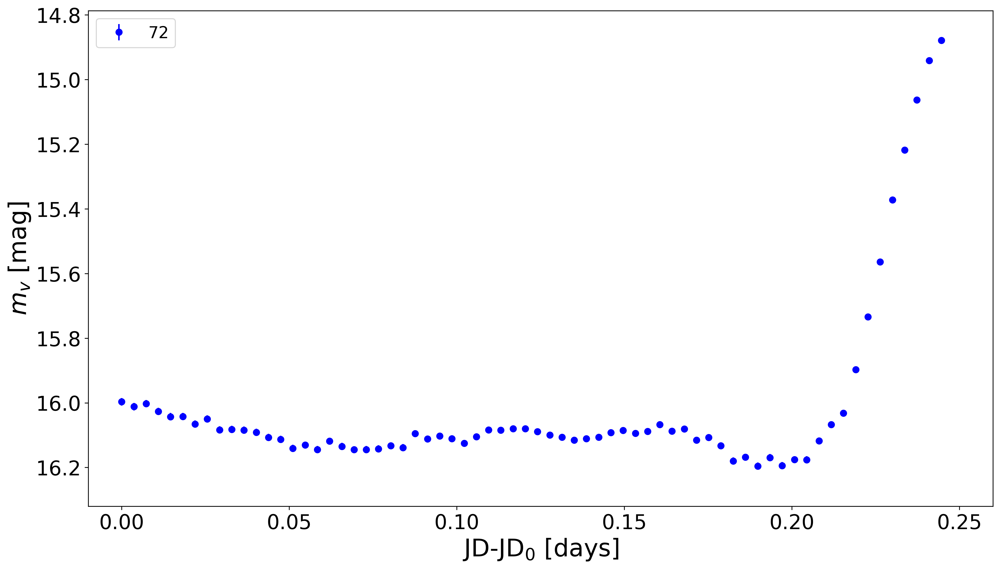

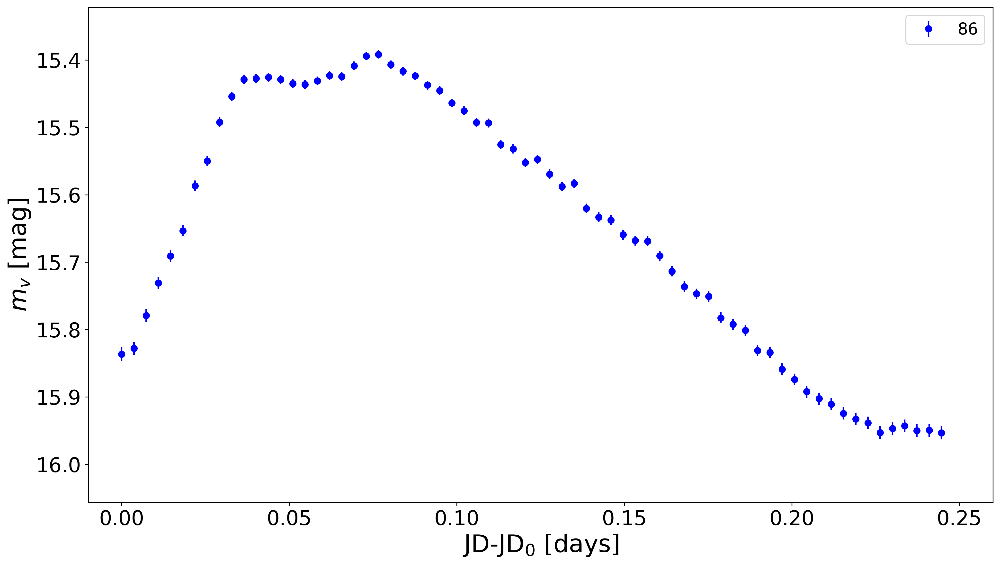

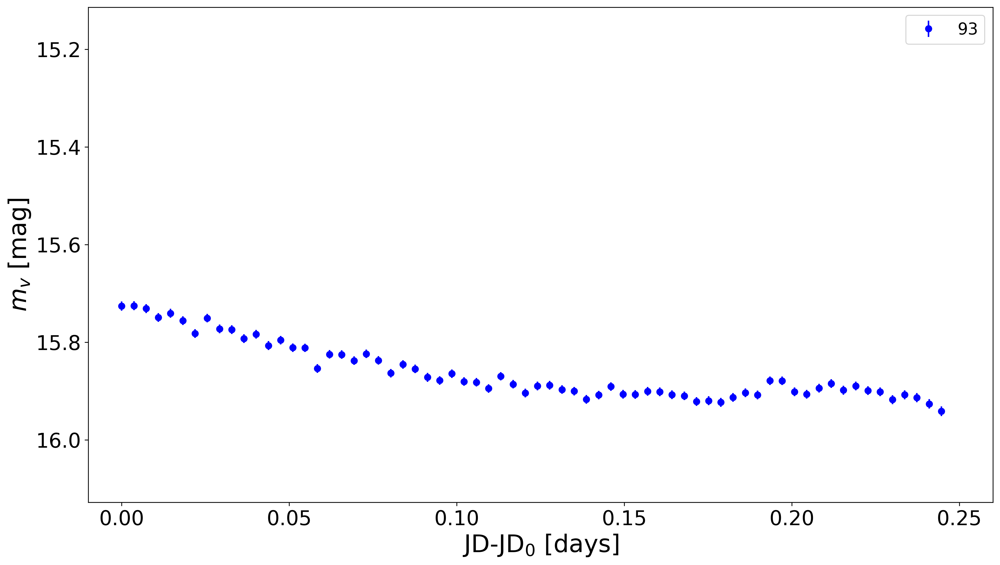

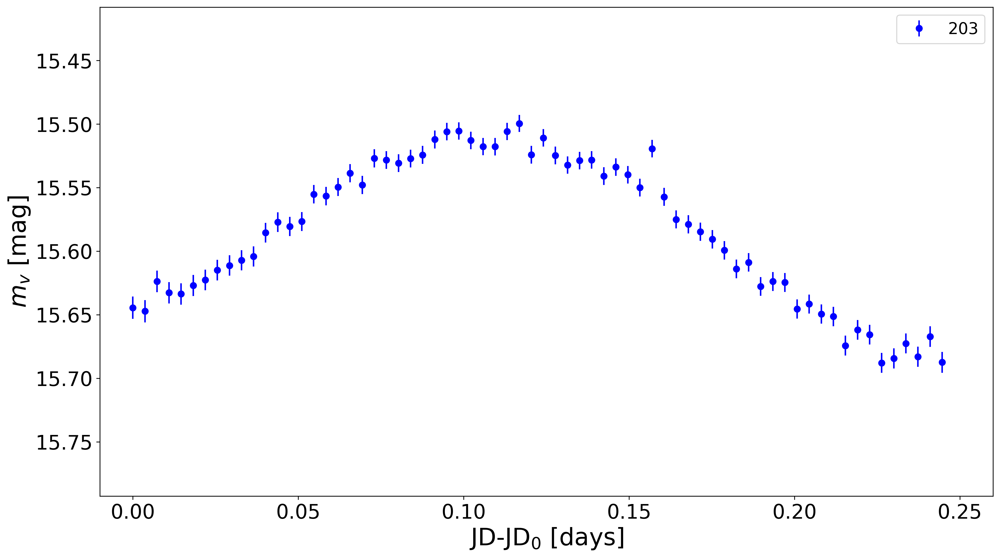

In [12]:
# Make the light curves
for i in range(4):
    vmin, vmax = np.max(phot_data['mag_app'][:, i]) + 0.07, np.min(phot_data['mag_app'][:, i]) - 0.07
    fig, ax = initPlot((1, 1), [['JD-JD$_0$ [days]', '$m_v$ [mag]']], [[[-0.01, 0.26], [vmin, vmax]]])
    ax[0][0].errorbar(phot_data['jd'] - phot_data['jd'][0], phot_data['mag_app'][:, i], fmt='bo', yerr=phot_data['mag_ins_err'][:, i], label=phot['name'][i])
    ax[0][0].legend(fontsize=16)
    fig.savefig('./rr_lyr_lightcurve_' + phot['name'][i] + '.pdf', bbox_inches='tight', pad_inches=0)